In [114]:
import dtale

import sys
import os
from dataprep.eda import create_report
from pandas_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class
import pandas as pd 
import matplotlib.pyplot as plt
%matplotlib inline

import sys; sys.path.insert(0, '..') # add parent folder path where src folder is
from src.utils import load_parquet, load_yaml

In [119]:
plt.rcParams['figure.dpi'] = 300
params = {'legend.fontsize': 10,
         'axes.labelsize': 10,
         'axes.titlesize': 10,
         'xtick.labelsize': 10,
         'ytick.labelsize': 10}
plt.rcParams.update(params)

In [116]:
main_config = load_yaml(path='../config/config.yaml')
data_acquisition_config = load_yaml(path='../config/data_acquisition/config.yaml')
cik = data_acquisition_config.cik
data_df = load_parquet(path='../'+main_config.path.clean_data_path)
data_df.transactionPricePerShare = data_df.transactionPricePerShare.astype(float)
data_df.transactionShares = data_df.transactionShares.astype(float)
data_df.transactionDate = data_df.transactionDate.apply(pd.to_datetime)
data_df = data_df[data_df['derivative_type']=='nonDerivativeTable']


In [117]:
import yfinance as yf

hist_dict = {}
for ticker in cik.keys():
    t = yf.Ticker(ticker)
    hist = t.history(period='4000d')
    hist_dict[ticker] = hist

******************************
Correlation between transactionShares and transactionPricePerShare: -0.09959645540625663
Trading Symbol: AAPL
Describe:
         transactionShares  transactionPricePerShare
count       4.630000e+02                463.000000
mean        3.569712e+04                212.180192
std         1.407571e+05                146.145895
min         1.000000e+00                  7.475000
25%         2.882417e+03                117.635000
50%         9.461000e+03                153.630000
75%         2.500000e+04                241.273750
max         2.653560e+06                700.095000
******************************
Correlation between transactionShares and transactionPricePerShare: -0.19783684701846757
Trading Symbol: AMZN
Describe:
         transactionShares  transactionPricePerShare
count         216.000000                216.000000
mean         4056.157254               1751.102345
std          9804.777329               1073.875966
min             2.222222       

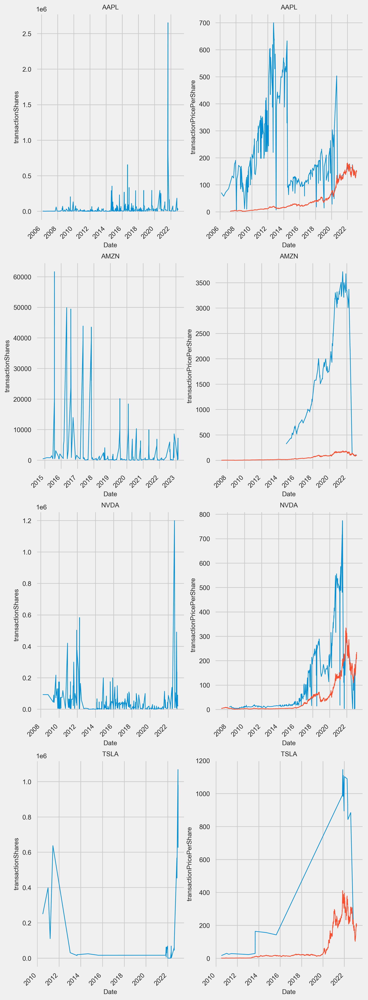

In [121]:
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(8, 25))

for group, i in zip(data_df.groupby('issuerTradingSymbol'), range(4)):
    print('*'*30)
    sub_group = group[1].groupby('transactionDate').mean()
    corr = sub_group['transactionShares'].corr(sub_group['transactionPricePerShare'])
    print(f"Correlation between transactionShares and transactionPricePerShare: {corr}")
    print("Trading Symbol:", group[0])
    print("Describe:\n ", sub_group.describe(include='all'))
    ax = axs[i, 0]
    ax.plot(sub_group.index, sub_group.transactionShares, linewidth = '1')
    ax.grid(True)
    ax.set_title(group[0])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.set_yscale('linear')
    ax.set_xlabel('Date', fontsize=10)
    ax.set_ylabel('transactionShares', fontsize=10)
    

    ax = axs[i, 1]
    ax.plot(sub_group.index, sub_group.transactionPricePerShare, linewidth = '1')
    ax.plot(hist_dict[group[0]].index, hist_dict[group[0]].Open, linewidth = '1')
    ax.grid(True)
    ax.set_title(group[0])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.set_yscale('linear')
    ax.set_xlabel('Date', fontsize=10)
    ax.set_ylabel('transactionPricePerShare', fontsize=10)


In [10]:
profile = ProfileReport(data_df, title="Report")
profile.to_file('report.html')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/892 [00:00<?, ?it/s]

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning:

invalid value encountered in divide

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



DataPrep Report
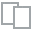
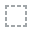
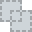
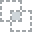
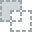
...
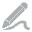
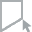
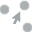
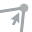
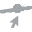

In [15]:
create_report(data_df)

In [4]:
dtale.show(data_df)

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dtale/views.py:1961: FutureWarning:

The default value of regex will change from True to False in a future version.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dtale/views.py:1961: FutureWarning:

The default value of regex will change from True to False in a future version.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dtale/views.py:1961: FutureWarning:

The default value of regex will change from True to False in a future version.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dtale/views.py:1961: FutureWarning:

The default value of regex will change from True to False in a future version.

/Users/alizamani/miniconda3/envs/scraping-env/lib/python3.9/site-packages/dtale/views.py:1961: FutureWarning:

The default value of regex will change from True to False in a future version.

/Users/alizamani/miniconda3/envs/scraping-env